## <font color=Lightcoral>1. Data Loading</font>

In [1]:
# Importing neccesary libraries.

import pandas as pd
import seaborn as sns
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
from sklearn.preprocessing import StandardScaler
pd.set_option('display.max_columns', 500)

In [2]:
import pandas as pd
hotel_raw_df = pd.read_csv('hotel-booking-demand/hotel_bookings.csv')
hotel_raw_df.shape

(119390, 32)

In [3]:
hotel_raw_df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [4]:
# checking data types
hotel_raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [5]:
# look at the statistical aspects of the dataframes
hotel_raw_df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


## <font color=Lightcoral>2. Data Cleaning</font>

In [6]:
#Checking the missing values in the columns

hotel_raw_df.isnull().sum().sort_values(ascending=False).head(10)

company                   112593
agent                      16340
country                      488
children                       4
reserved_room_type             0
assigned_room_type             0
booking_changes                0
deposit_type                   0
hotel                          0
previous_cancellations         0
dtype: int64

In [7]:
#Column-wise null percentage

print(round(100*(hotel_raw_df.isnull().sum()/len(hotel_raw_df.index)),2).sort_values(ascending=False).head(10))

company                        94.31
agent                          13.69
country                         0.41
hotel                           0.00
previous_cancellations          0.00
reservation_status              0.00
total_of_special_requests       0.00
required_car_parking_spaces     0.00
adr                             0.00
customer_type                   0.00
dtype: float64


In [8]:
#Copy the raw data for manipulation
hotel = hotel_raw_df.copy()

In [9]:
# fill empty agent & company information with 0

hotel[['company', 'agent']] = hotel[['company', 'agent']].fillna(0.0)

In [10]:
hotel = hotel.dropna(axis = 0)

hotel.isnull().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
arrival_date_week_number          0
arrival_date_day_of_month         0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
babies                            0
meal                              0
country                           0
market_segment                    0
distribution_channel              0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
reserved_room_type                0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
agent                             0
company                           0
days_in_waiting_list              0
customer_type                     0
adr                         

<font color=yellowgreen> Now missing values are removed. </font> 

In [11]:
#Drop other meaningless values
#Data with zero guests
filter = (hotel.children == 0) & (hotel.adults == 0) & (hotel.babies == 0)
hotel = hotel[~filter]
hotel.shape

(118728, 32)

In [12]:
filter = hotel.adr < 0
hotel = hotel[~filter]
hotel.shape

(118727, 32)

In [13]:
#Merge 
country_code = pd.read_csv('hotel-booking-demand/countries_codes_and_coordinates.csv')
country_code['country'] = country_code['Alpha-3 code'].str.replace('"','')
del country_code['Numeric code']
del country_code['Alpha-2 code']
del country_code['Alpha-3 code']
del country_code['Latitude (average)']
del country_code['Longitude (average)']
country_code['country'] = country_code['country'].str.replace(' ','')
hotel = pd.merge(hotel, country_code)
hotel.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,Country
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,0.0,0.0,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,0.0,0.0,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal
2,Resort Hotel,0,0,2015,July,27,1,0,2,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,0.0,0.0,0,Transient,107.0,0,0,Check-Out,2015-07-03,Portugal
3,Resort Hotel,0,9,2015,July,27,1,0,2,2,0.0,0,FB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,303.0,0.0,0,Transient,103.0,0,1,Check-Out,2015-07-03,Portugal
4,Resort Hotel,1,85,2015,July,27,1,0,3,2,0.0,0,BB,PRT,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,0.0,0,Transient,82.0,0,1,Canceled,2015-05-06,Portugal


<font color=green> **Data type transformation** </font>

<font color=green> **Rename the columns for better readability** </font>

In [14]:
hotel.columns = ['Hotel', 'Canceled', 'LeadTime', 'ArrivingYear', 'ArrivingMonth', 'ArrivingWeek','ArrivingDate', 'WeekendStay',
              'WeekStay', 'Adults', 'Children', 'Babies', 'Meal', 'CountryCode', 'Segment', 'DistChannel','RepeatGuest', 'PrevCancel',
              'PrevBook', 'BookRoomType','AssignRoomType', 'ChangeBooking', 'DepositType', 'Agent', 'Company', 'WaitingDays', 
              'CustomerType', 'ADR','ParkSpace', 'SpecialRequest','Reservation', 'ReservationDate' ,'Country']
hotel['Company'] = hotel['Company'].astype(bool)
hotel['Agent'] = hotel['Agent'].astype(bool)

In [15]:
hotel.head()

,Hotel,Canceled,LeadTime,ArrivingYear,ArrivingMonth,ArrivingWeek,ArrivingDate,WeekendStay,WeekStay,Adults,Children,Babies,Meal,CountryCode,Segment,DistChannel,RepeatGuest,PrevCancel,PrevBook,BookRoomType,AssignRoomType,ChangeBooking,DepositType,Agent,Company,WaitingDays,CustomerType,ADR,ParkSpace,SpecialRequest,Reservation,ReservationDate,Country
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,False,False,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,False,False,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal
2,Resort Hotel,0,0,2015,July,27,1,0,2,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,False,False,0,Transient,107.0,0,0,Check-Out,2015-07-03,Portugal
3,Resort Hotel,0,9,2015,July,27,1,0,2,2,0.0,0,FB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,True,False,0,Transient,103.0,0,1,Check-Out,2015-07-03,Portugal
4,Resort Hotel,1,85,2015,July,27,1,0,3,2,0.0,0,BB,PRT,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,True,False,0,Transient,82.0,0,1,Canceled,2015-05-06,Portugal


<font color=green> **Identify Continuous and Categorical Variables** </font>

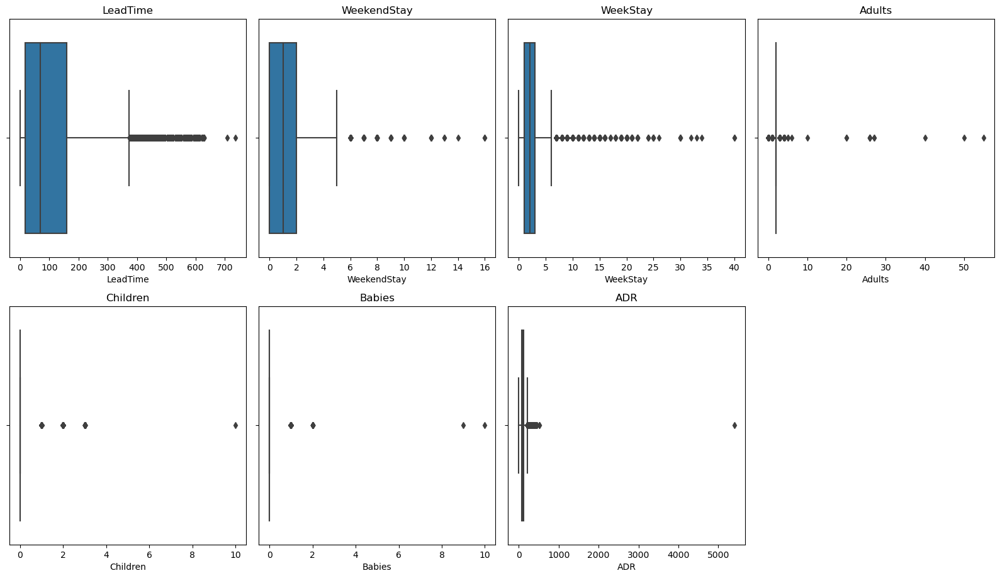

In [16]:
# Creating a boxplot for Outlier detection
features = ['LeadTime', 'WeekendStay', 'WeekStay', 'Adults','Children', 'Babies','ADR']
n = 1
plt.figure(figsize=(16,18))
for feature in features:
    plt.subplot(4,4,n)
    plt.title(feature)
    sns.boxplot(x = hotel[feature])
    n+=1
    plt.tight_layout()

In [17]:
#Copy the hotel data as hotel_outlier data for later outlier handlement
hotel_outlier = hotel.copy()

In [18]:
hotel_outlier.loc[hotel_outlier.LeadTime      > 400,'LeadTime'     ]=400
hotel_outlier.loc[hotel_outlier.WaitingDays   >   0,'WaitingDays'  ]=  1
hotel_outlier.loc[hotel_outlier.WeekendStay   >=  5,'WeekendStay'  ]=  5

hotel_outlier.loc[hotel_outlier.PrevBook      >   0,'PrevBook'     ]=  1
hotel_outlier.loc[hotel_outlier.PrevCancel    >   0,'PrevCancel'   ]=  1
hotel_outlier.loc[hotel_outlier.WeekStay      >  10,'WeekStay'     ]= 10
hotel_outlier.loc[hotel_outlier.ChangeBooking >   5,'ChangeBooking']=  5

In [19]:
hotel_outlier.loc[hotel_outlier.Adults > 4,'Adults'] = 4
hotel_outlier.loc[hotel_outlier.Babies > 8,'Babies'] = 0

hotel_outlier.loc[hotel_outlier.Children  > 8,'Children']  = 0

## <font color=Lightcoral>3. Data Prepareation</font>

In [20]:
#Combine children and babies numbers and save as Kids
hotel['Kids'] = hotel.Children + hotel.Babies

#Combine total mumbers by adding kids and adults
hotel['total_members'] = hotel.Kids + hotel.Adults


In [21]:
#convert the datatypes to string
hotel['ArrivingYear'] = hotel['ArrivingYear'].astype('str')
hotel['ArrivingMonth'] = hotel['ArrivingMonth'].astype('str')
hotel['ArrivingDate'] = hotel['ArrivingDate'].astype('str')

hotel['Canceled'] = hotel['Canceled'].astype('str')
hotel['RepeatGuest'] = hotel['RepeatGuest'].astype('str')
hotel.head()

,Hotel,Canceled,LeadTime,ArrivingYear,ArrivingMonth,ArrivingWeek,ArrivingDate,WeekendStay,WeekStay,Adults,Children,Babies,Meal,CountryCode,Segment,DistChannel,RepeatGuest,PrevCancel,PrevBook,BookRoomType,AssignRoomType,ChangeBooking,DepositType,Agent,Company,WaitingDays,CustomerType,ADR,ParkSpace,SpecialRequest,Reservation,ReservationDate,Country,Kids,total_members
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,False,False,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal,0.0,2.0
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,False,False,0,Transient,0.0,0,0,Check-Out,2015-07-01,Portugal,0.0,2.0
2,Resort Hotel,0,0,2015,July,27,1,0,2,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,False,False,0,Transient,107.0,0,0,Check-Out,2015-07-03,Portugal,0.0,2.0
3,Resort Hotel,0,9,2015,July,27,1,0,2,2,0.0,0,FB,PRT,Direct,Direct,0,0,0,C,C,0,No Deposit,True,False,0,Transient,103.0,0,1,Check-Out,2015-07-03,Portugal,0.0,2.0
4,Resort Hotel,1,85,2015,July,27,1,0,3,2,0.0,0,BB,PRT,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,True,False,0,Transient,82.0,0,1,Canceled,2015-05-06,Portugal,0.0,2.0


## <font color=Lightcoral>4. EDA</font>

#### <font color=Blue>Adults Number</font>

In [25]:
hotel['adults_group'] = pd.cut(hotel['Adults'], [0, 1, 2, 3, 4, 55], labels=['1', '2', '3', '4', '>=4'])

hotel.adults_group.value_counts(normalize=True)

2      0.753781
1      0.193005
3      0.052562
4      0.000517
>=4    0.000135
Name: adults_group, dtype: float64

#### <font color=Blue>Country</font>

In [26]:
num_countries = hotel['Country'].nunique()
num_countries

184

In [27]:
hotel.Country.value_counts(normalize=True).head(10)

Portugal          0.409735
United Kingdom    0.102427
France            0.087907
Spain             0.072347
Germany           0.061571
Italy             0.031787
Ireland           0.028516
Belgium           0.019794
Brazil            0.018780
Netherlands       0.017774
Name: Country, dtype: float64

Around 41% of all bookings were booked from Portugal.

In [28]:
hotel[hotel['Hotel'] == 'City Hotel'].Country.value_counts(normalize=True).head(10)

Portugal          0.389476
France            0.110960
Germany           0.076767
United Kingdom    0.066985
Spain             0.058112
Italy             0.041678
Belgium           0.023906
Brazil            0.022619
United States     0.020372
Netherlands       0.020056
Name: Country, dtype: float64

In [29]:
hotel[hotel['Hotel'] == 'Resort Hotel'].Country.value_counts(normalize=True).head(10)

Portugal          0.450794
United Kingdom    0.174260
Spain             0.101200
Ireland           0.055409
France            0.041186
Germany           0.030774
Netherlands       0.013149
United States     0.012253
Italy             0.011742
Belgium           0.011460
Name: Country, dtype: float64

The result shows some differences amoung the two hotels. 

#### <font color=Blue>Month</font>

In [30]:
hotel.ArrivingMonth.value_counts(normalize=True)

August       0.116728
July         0.105233
May          0.098607
April        0.093545
October      0.093325
June         0.091634
September    0.087459
March        0.081712
February     0.067724
November     0.057092
December     0.056805
January      0.050136
Name: ArrivingMonth, dtype: float64

August is the most occupied (busiest) month with 11.62% bookings and January is the most unoccupied month with 4.96% bookings.

#### <font color=Blue>Market Segment</font>

In [31]:
hotel.Segment.value_counts(normalize=True)

Online TA        0.475980
Offline TA/TO    0.201761
Groups           0.166188
Direct           0.104532
Corporate        0.043417
Complementary    0.006136
Aviation         0.001986
Name: Segment, dtype: float64

Around 47% of bookings are made via Online Travel Agents, almost 20% of bookings are made via Offline Travel Agents and less than 20% are Direct bookings without any other agents.

#### <font color=Blue>Meal</font>

In [32]:
hotel.Meal.value_counts(normalize=True)

BB           0.772833
HB           0.121799
SC           0.088871
Undefined    0.009770
FB           0.006728
Name: Meal, dtype: float64

Out of the meals, BB (Bed & Breakfast) is the most ordered meal which is around 77.2%, followed by HB(Half Board), SC(no meal package), Undefined and FB (Full Board).

#### <font color=Blue>Customer Type</font>

In [33]:
hotel.CustomerType.value_counts(normalize=True)

Transient          0.74992
Transient-Party    0.21072
Contract           0.03461
Group              0.00475
Name: CustomerType, dtype: float64

In [34]:
hotel.Reservation.value_counts(normalize=True)

Check-Out    0.626371
Canceled     0.363427
No-Show      0.010201
Name: Reservation, dtype: float64

Transient type of customers are the more around 75%.
63% visitors checked out and 36% bookings were canceled

## <font color=Lightcoral>5. Data Visualization</font>

Text(0.5, 1.0, 'Arriving year, Leadtime and Cancelations')

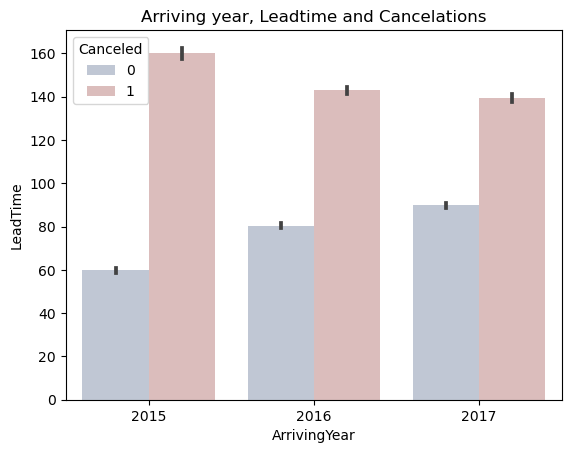

In [35]:
plt.figure()
sns.barplot(x='ArrivingYear', y='LeadTime',hue='Canceled', data= hotel, palette='vlag')
plt.title('Arriving year, Leadtime and Cancelations')

#### <font color=Blue>Family Status</font>

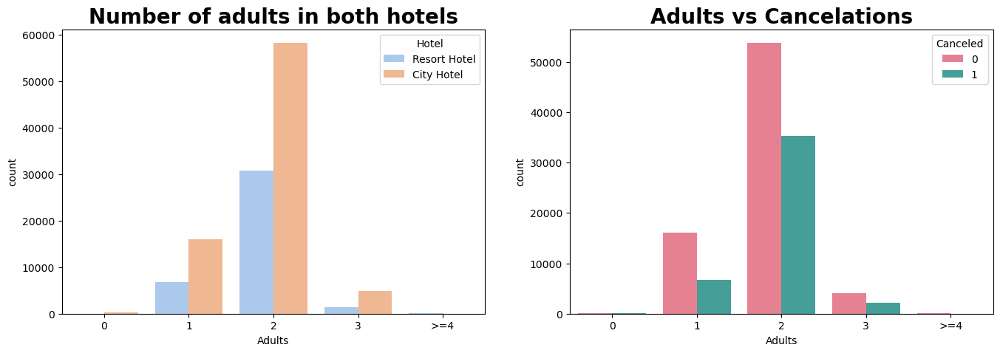

In [36]:
plt.figure(figsize=(8, 5))
plt.subplot(1, 2, 1)
sns.countplot(x='Adults',hue='Hotel', data=hotel_outlier, palette='pastel')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2, 3, '>=4'])
plt.title("Number of adults in both hotels",fontweight="bold", size=20)
plt.subplot(1, 2, 2)
sns.countplot(data = hotel_outlier, x = 'Adults', hue='Canceled', palette='husl')
plt.xticks([0, 1, 2, 3, 4], [0, 1, 2, 3, '>=4'])
plt.title('Adults vs Cancelations',fontweight="bold", size=20)
plt.subplots_adjust(right=1.7)


plt.show()

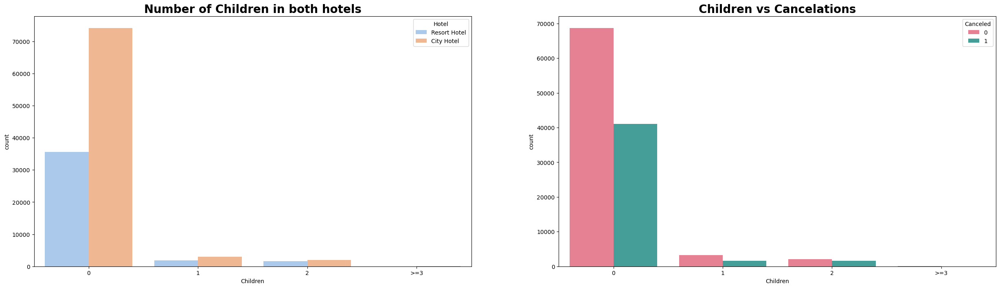

In [37]:
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
sns.countplot(x='Children',hue='Hotel', data=hotel_outlier, palette='pastel')
plt.title("Number of Children in both hotels",fontweight="bold", size=20)
plt.xticks([0, 1, 2, 3], [0, 1, 2, '>=3'])
plt.subplot(1, 2, 2)
sns.countplot(data = hotel_outlier, x = 'Children', hue='Canceled', palette='husl')
plt.title('Children vs Cancelations',fontweight="bold", size=20)
plt.xticks([0, 1, 2, 3], [0, 1, 2, '>=3'])
plt.subplots_adjust(right=1.7)


plt.show()

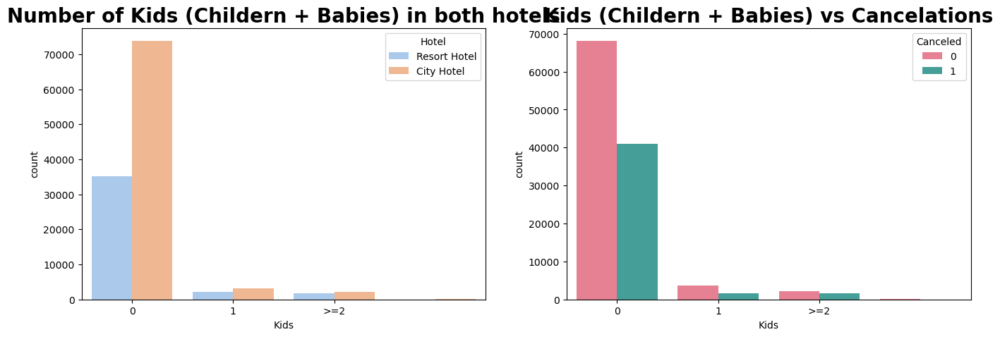

In [38]:
hotel_outlier['Kids'] = hotel_outlier['Children'] + hotel_outlier['Babies']
plt.figure(figsize=(8, 5))
plt.subplot(1, 2, 1)
sns.countplot(x='Kids',hue='Hotel', data=hotel_outlier, palette='pastel')
plt.title("Number of Kids (Childern + Babies) in both hotels",fontweight="bold", size=20)
plt.xticks([0, 1, 2], [0, 1, '>=2'])

plt.subplot(1, 2, 2)
sns.countplot(data = hotel_outlier, x = 'Kids', hue='Canceled', palette='husl')
plt.title('Kids (Childern + Babies) vs Cancelations',fontweight="bold", size=20)
plt.subplots_adjust(right=1.7)
plt.xticks([0, 1, 2], [0, 1, '>=2'])


plt.show()

#### <font color=Blue>Guests Home Country</font>

In [39]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.colors import n_colors
from plotly.subplots import make_subplots
# Minmax scaler
from sklearn.preprocessing import MinMaxScaler

In [40]:
country_visitors = hotel[hotel['Canceled'] == '0'].groupby(['CountryCode']).size().sort_values(ascending = False).reset_index(name = 'count')
country_visitors.head(10)

,CountryCode,count
0,PRT,20977
1,GBR,9667
2,FRA,8468
3,ESP,6383
4,DEU,6067
5,IRL,2542
6,ITA,2428
7,BEL,1868
8,NLD,1716
9,USA,1592


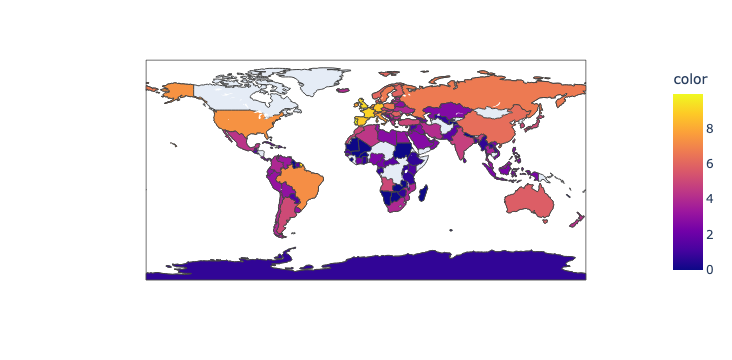

In [41]:
import plotly.express as px

px.choropleth(country_visitors,
                    locations = country_visitors["CountryCode"],
                    color=np.log(country_visitors['count']), 
                    
                    hover_name= country_visitors["CountryCode"], # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma,
                    
                    )

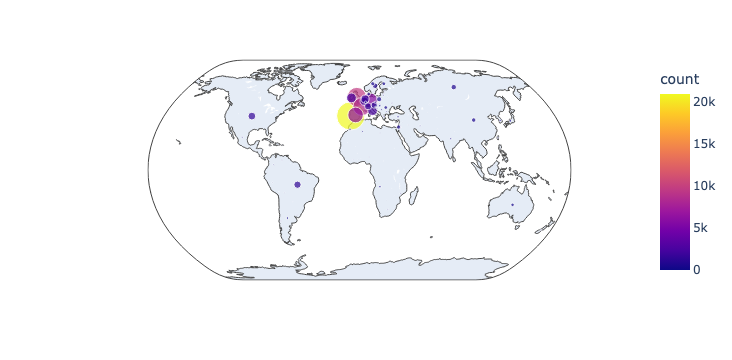

In [42]:
fig = px.scatter_geo(country_visitors, 
                     locations="CountryCode", 
                     color="count", 
                     hover_name="CountryCode", 
                     size="count",
                     projection="natural earth")
fig.show()

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/2317765563.py:11: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/2317765563.py:17: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



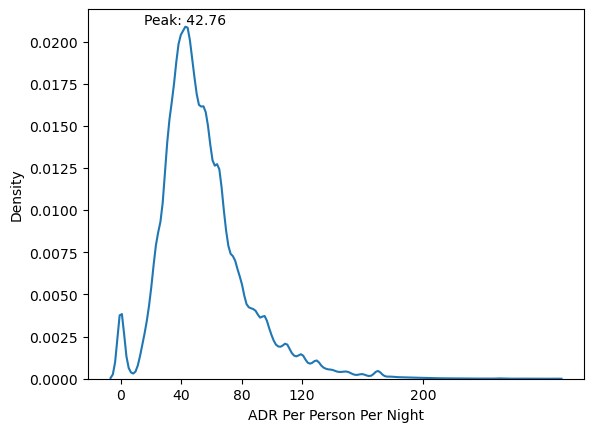

In [43]:
# normalize price per night (adr):
hotel_outlier["adr_pp"] = hotel_outlier["ADR"] / (hotel_outlier["Adults"] + hotel_outlier["Kids"])
hotel_df_guests = hotel_outlier.loc[hotel["Canceled"] == 0]
hotel_df_guests

# plot kernal density curve
xmin = 0
xmax = 300
cut_data = hotel_outlier[(hotel_outlier["adr_pp"] >= xmin) & (hotel_outlier["adr_pp"] <= xmax)]

ax = sns.kdeplot(data=cut_data[hotel_outlier['Canceled'] == 0], x='adr_pp', bw_adjust=0.75)

ax.set_xticks([0, 40, 80, 120, 200])
ax.set_xticklabels(["0", "40", "80", "120", "200"])

# identify peek value
density = sns.kdeplot(data=cut_data[hotel_outlier['Canceled'] == '0'], x='adr_pp', bw_adjust=0.75).get_lines()[0].get_data()
x_peak = density[0][np.argmax(density[1])]

plt.text(x_peak, max(density[1]), f"Peak: {x_peak:.2f}", ha='center', va='bottom')
plt.xlabel('ADR Per Person Per Night')

plt.show()

In [44]:
hotel_outlier["adr_pp"].mode()

0    31.0
Name: adr_pp, dtype: float64

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/3209177324.py:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



[Text(0, 0, '0'),
 Text(40, 0, '40'),
 Text(80, 0, '80'),
 Text(120, 0, '120'),
 Text(200, 0, '200')]

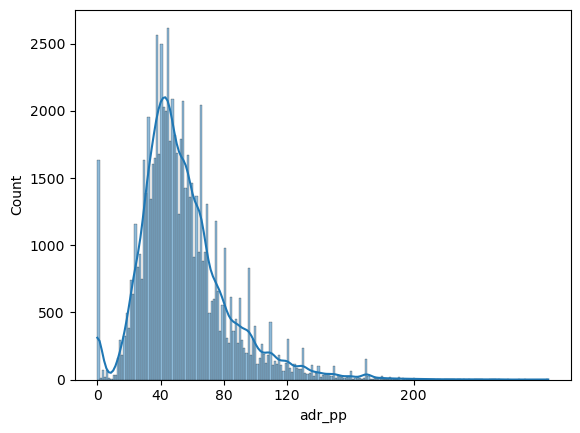

In [45]:
# 绘制直方图
ax = sns.histplot(data=cut_data[hotel_outlier['Canceled'] == 0], x='adr_pp', kde=True)

# 设置横坐标刻度和标签
ax.set_xticks([0, 40, 80, 120, 200])
ax.set_xticklabels(["0", "40", "80", "120", "200"])

In [46]:
hotel_outlier["adr_pp"].mean()

55.104104383948346

#### <font color=Blue>Meal Analysis</font>

In [47]:
from plotly.offline import init_notebook_mode, iplot
import plotly.figure_factory as ff
import cufflinks as cf
import plotly.io as pio 
cf.go_offline()

In [48]:
#import cufflinks as cf
pd.options.plotting.backend = "plotly"

In [49]:
#temp = hotel[hotel['Canceled']==0].Meal.value_counts().to_frame().reset_index()
meal = hotel['Meal'].value_counts().to_frame().reset_index()
meal

,index,Meal
0,BB,91440
1,HB,14411
2,SC,10515
3,Undefined,1156
4,FB,796


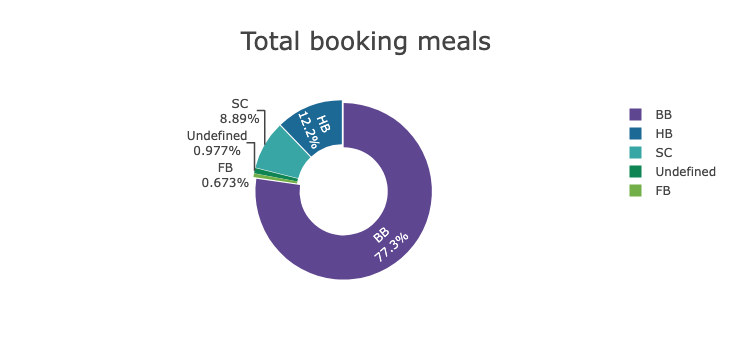

In [50]:
layout = cf.Layout(title='Total booking meals', titlefont=dict(size=25),
                  xaxis=dict(title=''),yaxis=dict(title=''))
colors = px.colors.qualitative.Prism


meal.iplot(kind='pie',
           labels='index',
           values='Meal',
           hole=0.5,pull=0.02,
           layout=layout,
           color=colors,
           textinfo='label+percent')

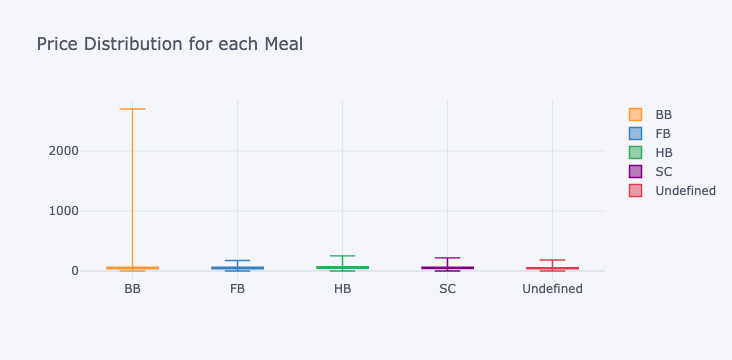

In [51]:
temp = pd.DataFrame(index=hotel.index)
hotel_outlier['price'] = hotel_outlier['ADR'].div(hotel_outlier['Adults'] + hotel_outlier['Kids'])
for m in hotel_outlier['Meal'].unique():
    temp[m] = pd.Series(hotel_outlier[hotel_outlier['Meal']==m]['price'].values)
    
temp.iplot(kind='box', mean=True, title='Price Distribution for each Meal')

#### <font color=Blue>Market Segmentation</font>

In [52]:
market = hotel_outlier.groupby('Segment').sum()
market = market[['LeadTime','PrevCancel','PrevBook','Agent','adr_pp','SpecialRequest']]
market.head()

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/1388977830.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,LeadTime,PrevCancel,PrevBook,Agent,adr_pp,SpecialRequest
Segment,,,,,,
Aviation,1051,9,60,25,23563.680000,27
Complementary,9799,66,225,100,1514.460000,689
Corporate,116459,561,1618,690,309961.963333,1174
Direct,618783,177,679,6534,742180.236667,7101
Groups,3556147,3348,86,15509,942514.711667,1665


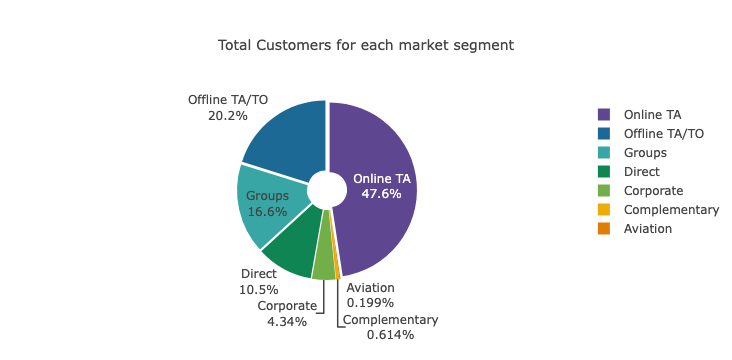

In [53]:
market = hotel_outlier['Segment'].value_counts().to_frame().rename(columns={'Segment':'total_members'}).reset_index()

layout = cf.Layout(title='Total Customers for each market segment',
                   titlefont=dict(size=14),
                  xaxis=dict(title=''),yaxis=dict(title=''))
colors = px.colors.qualitative.Prism

market.iplot(kind='pie',
           labels='index',
           values='total_members',
           textinfo='label+percent',
           hole=0.2,
           layout=layout,
           color=colors,
           pull=0.03,sort=True)

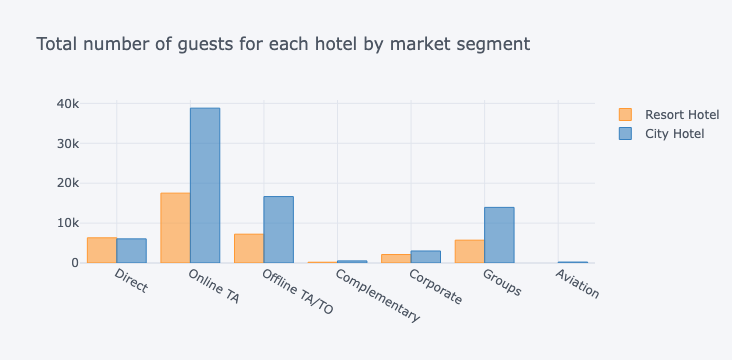

In [54]:
market = pd.DataFrame(index=hotel_outlier.Hotel.unique())
for seg in hotel_outlier['Segment'].unique():
    market[seg] = hotel_outlier[hotel_outlier['Segment']==seg]['Hotel'].value_counts()
    
market.T.iplot(kind='bar',title='Total number of guests for each hotel by market segment')

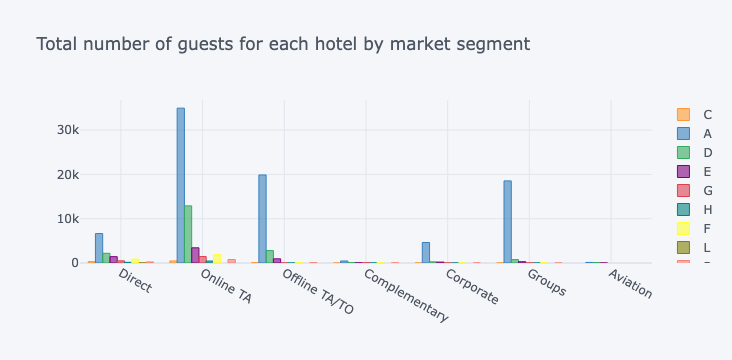

In [55]:
market = pd.DataFrame(index=hotel_outlier['BookRoomType'].unique())
for seg in hotel_outlier['Segment'].unique():
    market[seg] = hotel_outlier[hotel_outlier['Segment']==seg]['BookRoomType'].value_counts()
    
market.T.iplot(kind='bar',title='Total number of guests for each hotel by market segment')

#### <font color=Blue>Time Preferences</font>

In [56]:
import sort_dataframeby_monthorweek as sd

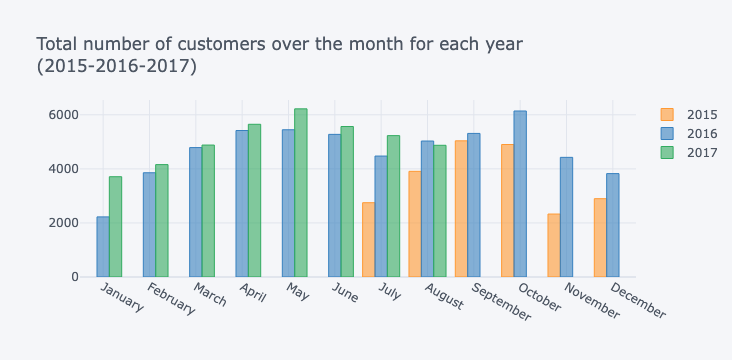

In [57]:
time = pd.DataFrame(index=hotel_outlier['ArrivingMonth'].unique())

for year in hotel_outlier['ArrivingYear'].unique():
    time[year] = hotel_outlier[hotel_outlier['ArrivingYear']==year]['ArrivingMonth'].value_counts()
    

#Sort month
time = time.reset_index()
time = sd.Sort_Dataframeby_Month(df=time,monthcolumnname='index').set_index('index')

time.iplot(kind='bar',
          title='Total number of customers over the month for each year<br>(2015-2016-2017)')

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/3813301274.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



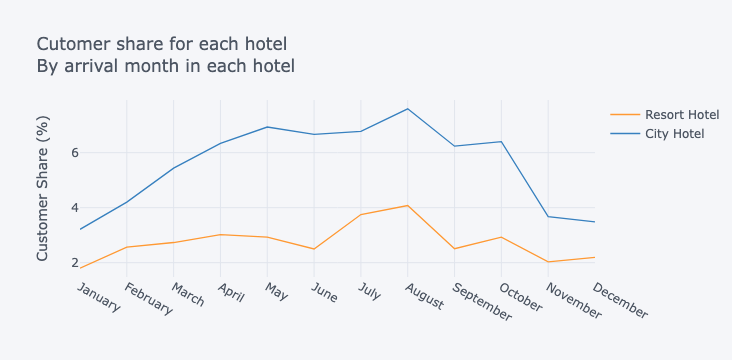

In [58]:
cnt = hotel_outlier.shape
temp = pd.DataFrame(index=hotel_outlier.groupby(hotel_outlier['ArrivingMonth']).sum().index)
for h in hotel_outlier['Hotel'].unique():
    temp[h] = hotel_outlier[hotel_outlier['Hotel']==h]['ArrivingMonth'].value_counts()/cnt[0]*100
    
#Sort month
temp = temp.sort_values('City Hotel',ascending=False).reset_index()
temp = sd.Sort_Dataframeby_Month(df=temp,monthcolumnname='ArrivingMonth').set_index('ArrivingMonth')
temp.iplot(kind='line',
           yTitle = 'Customer Share (%)',
           title='Cutomer share for each hotel<br>By arrival month in each hotel')


/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/1047168803.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



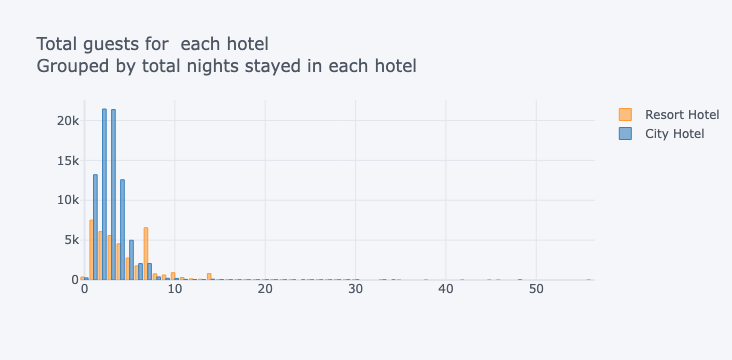

In [59]:
hotel['total_nights'] = hotel['WeekStay'] + hotel['WeekendStay']

temp = pd.DataFrame(index=hotel.groupby(hotel['total_nights']).sum().index)

for hot in hotel['Hotel'].unique():
    temp[hot] = hotel[hotel['Hotel']==hot]['total_nights'].value_counts()
    
temp = temp.sort_values('City Hotel',ascending=False)
temp.iplot(kind='bar',title='Total guests for  each hotel<br>Grouped by total nights stayed in each hotel')

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/281536522.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



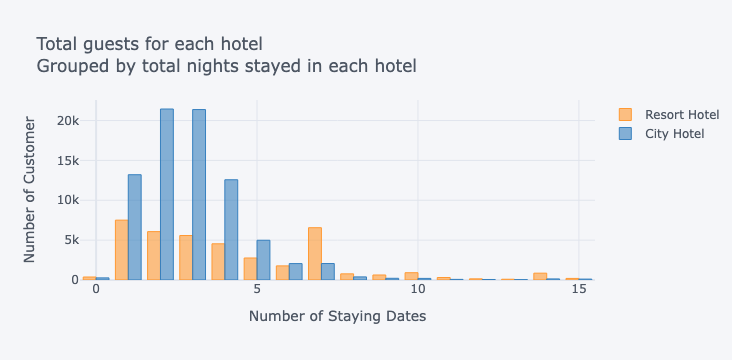

In [60]:
hotel_outlier['total_nights'] = hotel_outlier['WeekStay'] + hotel_outlier['WeekendStay']

temp = pd.DataFrame(index=hotel_outlier.groupby(hotel_outlier['total_nights']).sum().index)

for hot in hotel_outlier['Hotel'].unique():
    temp[hot] = hotel_outlier[hotel_outlier['Hotel']==hot]['total_nights'].value_counts()
    
temp = temp.sort_values('City Hotel',ascending=False)
temp.iplot(kind='bar',
           yTitle = 'Number of Customer',
           xTitle = 'Number of Staying Dates',
           title='Total guests for each hotel<br>Grouped by total nights stayed in each hotel')

In [61]:
hotel_outlier['total_members'] = hotel_outlier['Kids']+hotel_outlier['Adults']
#bins = [0, 1, 4, np.inf]
bins = [0, 1, 2, 5, np.inf]

# 定义每个分段的标签
labels = ['1', '2', '3-5', '>5']

# 使用cut函数将数据分段，并存储在新的列中
hotel_outlier['count_seg'] = pd.cut(hotel_outlier['total_members'].apply(lambda x: np.mean(x)), bins=bins, labels=labels).astype(str)
hotel_outlier['count_seg']

0         2
1         2
2         2
3         2
4         2
         ..
118313    2
118314    2
118315    2
118316    2
118317    2
Name: count_seg, Length: 118318, dtype: object

/var/folders/zj/27mc31l9089fr67j0nc9n0_40000gn/T/ipykernel_70403/3946390561.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



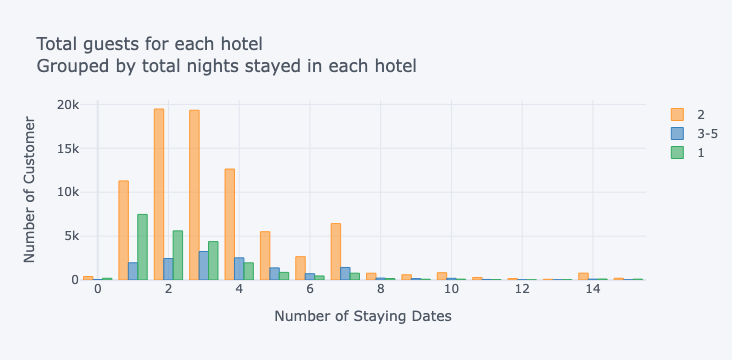

In [62]:
hotel_outlier['total_nights'] = hotel_outlier['WeekStay'] + hotel_outlier['WeekendStay']

temp = pd.DataFrame(index=hotel_outlier.groupby(hotel_outlier['total_nights']).sum().index)


for members in hotel_outlier['count_seg'].unique():
    #cnt = hotel_outlier[hotel_outlier['count_seg']==members].value_counts()
    temp[members] = hotel_outlier[hotel_outlier['count_seg']==members]['total_nights'].value_counts()
    
#temp = temp.sort_values('count_seg',ascending=False)
# temp
temp.iplot(kind='bar',
           yTitle = 'Number of Customer',
           xTitle = 'Number of Staying Dates',
           title='Total guests for each hotel<br>Grouped by total nights stayed in each hotel')

<Axes: title={'center': 'Relationship between Guests Counts and Stay Length'}, xlabel='stay_days_bin', ylabel='num_people_bin'>

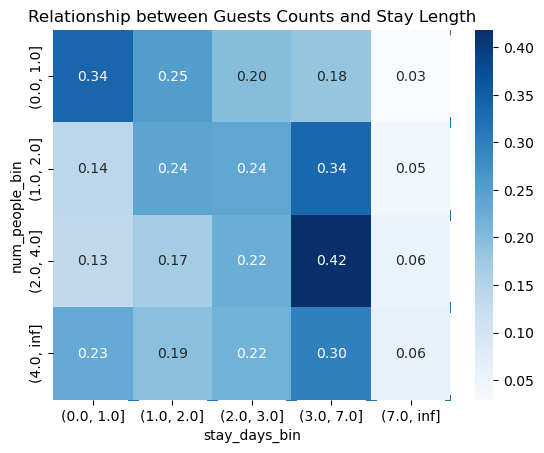

In [63]:
# plot scatter
plt.scatter(hotel_outlier['total_members'], hotel_outlier['total_nights'])

plt.title('Relationship between Guests Counts and Stay Length')
plt.xlabel('Total Guests')
plt.ylabel('Stay Length (days)')

hotel_outlier['num_people_bin'] = pd.cut(hotel_outlier['total_members'], bins=[0, 1, 2, 4, np.inf])
hotel_outlier['stay_days_bin'] = pd.cut(hotel_outlier['total_nights'], bins=[0, 1, 2, 3, 7, np.inf])


counts = hotel_outlier.groupby(['num_people_bin', 'stay_days_bin']).size().unstack()

proportions = counts.apply(lambda x: x / x.sum(), axis=1)

# plot heatmap
sns.heatmap(proportions, cmap='Blues', annot=True, fmt='.2f')

In [64]:
df_not_canceled = hotel_outlier[hotel_outlier.Canceled == 0]

In [65]:
def plot(x, y, x_label=None,y_label=None, title=None, figsize=(6,4), type='bar'):
    
    '''
    INPUT:
        x:        Array containing values for x-axis
        y:        Array containing values for y-axis
        x_lable:  String value for x-axis label
        y_lable:  String value for y-axis label
        title:    String value for plot title
        figsize:  tuple value, for figure size
        type:     type of plot (default is bar plot)
        
    OUTPUT:
        Display the plot
    '''
    
    sns.set_style('darkgrid')
    
    fig, ax = plt.subplots(figsize=figsize)
    
    ax.yaxis.set_major_formatter(mtick.PercentFormatter())
    
    if x_label != None:
        ax.set_xlabel(x_label)
    
    if y_label != None:
        ax.set_ylabel(y_label)
        
    if title != None:
        ax.set_title(title)
    
    if type == 'bar':
        sns.barplot(x = x, y = y, ax = ax, palette='vlag')
    elif type == 'line':
        sns.lineplot(x = x, y = y, ax = ax, sort=False)
        
    
    plt.show()

<Axes: >

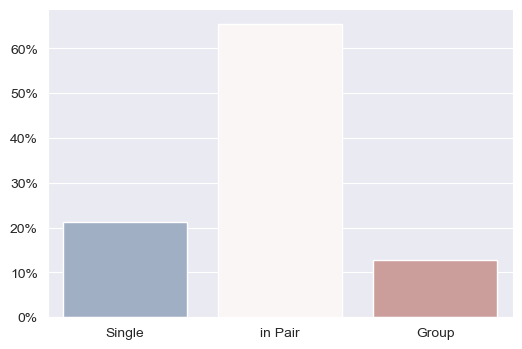

In [66]:
import matplotlib.ticker as mtick
## Select single, couple, multiple adults and family
single   = df_not_canceled[(df_not_canceled.Adults==1) & (df_not_canceled.Children==0) & (df_not_canceled.Babies==0)]
couple   = df_not_canceled[(df_not_canceled.Adults==2) & (df_not_canceled.Children==0) & (df_not_canceled.Babies==0)]
family   = df_not_canceled[df_not_canceled.Adults + df_not_canceled.Children + df_not_canceled.Babies > 2]


## Make the list of Category names, and their total percentage
names = ['Single', 'in Pair', 'Group']
count = [single.shape[0],couple.shape[0], family.shape[0]]
count_percent = [x/df_not_canceled.shape[0]*100 for x in count]


## Draw the bar chart
sns.set_style('darkgrid')
fig, ax = plt.subplots(figsize=(6,4))
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
sns.barplot(x = names, y = count_percent, ax = ax, palette='vlag')

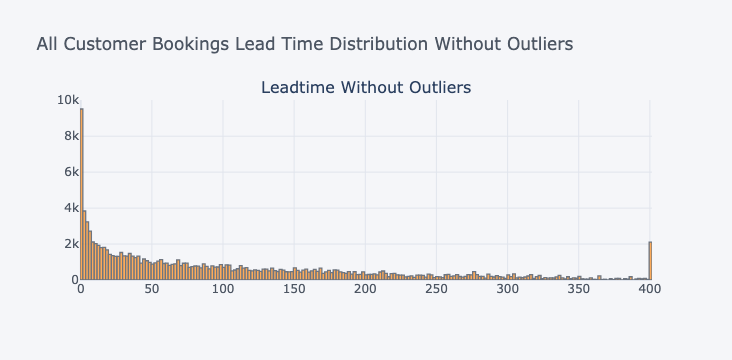

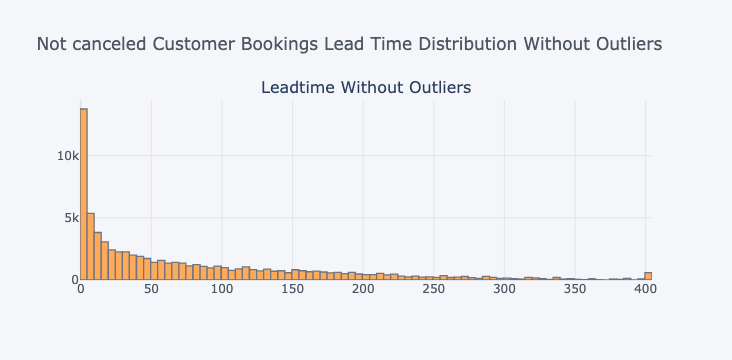

In [67]:
data_1 = hotel_outlier['LeadTime'].reset_index().rename(columns=lambda x:x.capitalize() +' Without Outliers')

# data_2 = hotel_outlier['LeadTime'].reset_index().rename(columns=lambda x:x.capitalize() +' Without Outliers')
data_1['Leadtime Without Outliers'].iplot(kind='hist',
                               subplots=True,
                               horizontal_spacing=.1,
                               fill=True,
                               subplot_titles=True,
                               title='All Customer Bookings Lead Time Distribution Without Outliers')

data_2 = df_not_canceled['LeadTime'].reset_index().rename(columns=lambda x:x.capitalize() +' Without Outliers')
data_2['Leadtime Without Outliers'].iplot(kind='hist',
                               subplots=True,
                               horizontal_spacing=.1,
                               fill=True,
                               subplot_titles=True,
                               title='Not canceled Customer Bookings Lead Time Distribution Without Outliers')

In [68]:
import sklearn.cluster as cluster

In [69]:
df = hotel[['LeadTime', 'ADR']]

In [70]:
K=range(1,12)
wss = []
for k in K:
    kmeans=cluster.KMeans(n_clusters=k,init="k-means++")
    kmeans=kmeans.fit(df)
    wss_iter = kmeans.inertia_
    wss.append(wss_iter)

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress t

In [71]:
mycenters = pd.DataFrame({'Clusters' : K, 'WSS' : wss})
mycenters

,Clusters,WSS
0,1,1.651522e+09
1,2,7.027875e+08
2,3,4.836524e+08
3,4,3.619531e+08
4,5,2.987789e+08
5,6,2.537520e+08
6,7,2.195013e+08
7,8,1.955784e+08
8,9,1.686930e+08
9,10,1.530665e+08


<Axes: xlabel='Clusters', ylabel='WSS'>

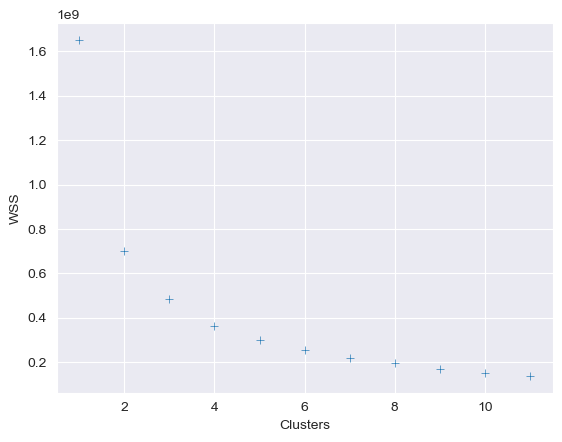

In [72]:
sns.scatterplot(x = 'Clusters', y = 'WSS', data = mycenters, marker="+")

In [73]:
kmeans = cluster.KMeans(n_clusters=4 ,init="k-means++")

In [74]:
kmeans = kmeans.fit(hotel_outlier[['ADR','LeadTime']])

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [75]:
kmeans.cluster_centers_

array([[168.81283191,  41.71920848],
       [ 85.76363495, 310.77508091],
       [ 76.235992  ,  30.730161  ],
       [103.86174843, 155.34660289]])

In [76]:
hotel_outlier['Clusters'] = kmeans.labels_
hotel_outlier['Clusters'].value_counts()

2    48940
3    31753
0    22194
1    15431
Name: Clusters, dtype: int64

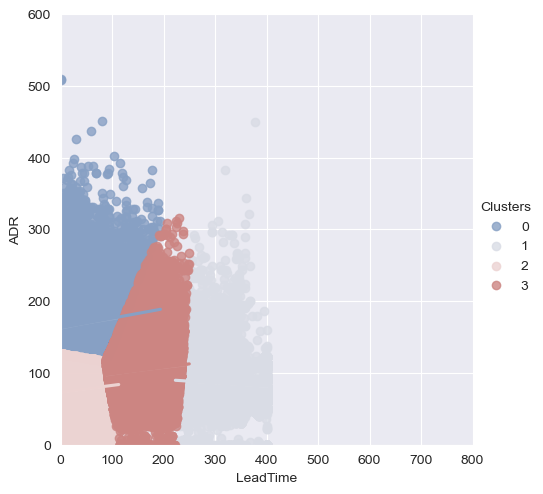

In [77]:
sns.lmplot(x="LeadTime", y="ADR",hue = 'Clusters',  data=hotel_outlier, palette='vlag')
plt.ylim(0, 600)
plt.xlim(0, 800)
plt.show()

In [78]:
from sklearn.preprocessing import StandardScaler

In [79]:
df_cluster = hotel_outlier[['LeadTime','total_nights', 'ADR']]

scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cluster)

In [80]:
kmeans = cluster.KMeans(n_clusters=4, random_state=0)
kmeans.fit(df_scaled)
df_cluster['cluster'] = kmeans.labels_

/Users/liuchang/opt/anaconda3/envs/DataMining/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



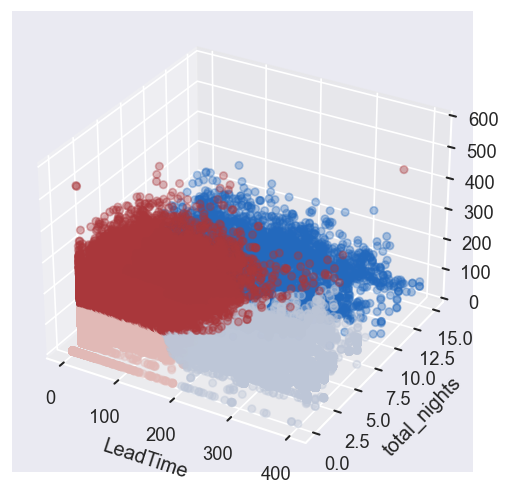

In [81]:
# Create 3D plot
sns.set(style='darkgrid')
fig = plt.figure(dpi=120)
fig.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df_cluster['LeadTime'], df_cluster['total_nights'], df_cluster['ADR'], c=df_cluster['cluster'], cmap='vlag')
ax.set_xlabel('LeadTime')
ax.set_ylabel('total_nights')

ax.set_zlim(0, 600)

plt.show()